In [1]:
import gensim
from gensim.models.callbacks import LossLogger, LossSetter
from IPython.display import HTML
import itertools
import logging
import matplotlib.pyplot as plt
from matplotlib import animation, rc, cm
from matplotlib.collections import LineCollection
import numpy as np
from numpy.linalg import norm
from numpy import dot
from scipy.spatial.distance import pdist, squareform
from sklearn.manifold import TSNE
import os
import plotly.plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import sys

init_notebook_mode(connected=True)
logging.basicConfig(level=logging.WARN)

ROOT = "/Users/alext/Documents/Master/Thesis/"

In [2]:
# Get vocabulary of the Google word analogy benchmark
def get_semantically_rich_words():
    filename = os.path.join(ROOT, "msc_tifreaa/gensim/test/test_data/questions-words.txt")

    def flatten(l):
        return [item for ll in l for item in ll]

    with open(filename, "r") as f:
        lines = [line.strip().split(" ") for line in f.readlines()]
        lines = list(filter(lambda l: l[0] is not ":", lines))
        words = list(set(flatten(lines)))
        
    words = ["one", "two", "three", "four", "five", "six", "seven", "eight", "nine", 
             "man", "woman", 
             "prince", "king", "queen",
             "french", "english", "spanish",
             "winter", "summer", "autumn", "spring",
             "monday", "tuesday", "wednesday", "thursday", "friday"] + words
    return [w.lower() for w in words]

# Get vocabulary of the word similarity benchmarks
def get_semantically_rich_words2():
    filename1 = os.path.join(ROOT, "msc_tifreaa/gensim/test/test_data/simlex999.txt")
    filename2 = os.path.join(ROOT, "msc_tifreaa/gensim/test/test_data/wordsim353.tsv")

    def flatten(l):
        return [item for ll in l for item in ll]

    with open(filename1, "r") as f1, open(filename2, "r") as f2:
        lines = [line.strip().split("\t")[:-1] for line in f1.readlines()][2:] + [line.strip().split("\t")[:-1] for line in f2.readlines()][2:]
        words = list(set(flatten(lines)))
        
#     words = ["one", "two", "three", "four", "five", "six", "seven", "eight", "nine", 
#              "man", "woman", 
#              "prince", "king", "queen",
#              "french", "english", "spanish",
#              "winter", "summer", "autumn", "spring",
#              "monday", "tuesday", "wednesday", "thursday", "friday"] + words
    return words


def plot_embeddings(wv, idxs, num_words=100):
    embeddings = np.array([wv.word_vec(w) for w in wv.index2entity])

    idxs = idxs[:num_words]
    
    l1 = go.Scatter(
        x=embeddings[idxs, 0],
        y=embeddings[idxs, 1],
        text=[wv.index2word[idx] for idx in idxs],
        textposition='top right',
        mode="markers+text")

    return iplot(dict(data=[l1]))

words = get_semantically_rich_words()

# 2D dot product embeddings on text8

In [3]:
model_fn = os.path.join(ROOT, "models/word2vec_baseline/w2v_text8_sg_5_2_A025_a0001_n10_w5_c5_cosine")
# model_fn = os.path.join(ROOT, "models/word2vec_baseline/w2v_levy_sg_3_2_A025_a0001_n10_w5_c100_cosine")
model = gensim.models.Word2Vec.load(model_fn)
wv = model.wv

rich_words = get_semantically_rich_words()
rich_idxs = [wv.vocab[w].index for w in filter(lambda w: w in wv.vocab, rich_words)]
print(len(rich_idxs))

904


#### Note: Notice how for 2D word2vec the words seem to be embedded on a line (perhaps in higher dimensions this is still a relatively limited submanifold. This is similar to what Fig 3 from Hashimoto et al shows

In [4]:
plot_embeddings(wv, rich_idxs, num_words=100)

# 2D Poincare embeddings on text8

In [5]:
hyp_model_fn = os.path.join(ROOT, "models/geometric_emb/w2v_text8_nll_5_2_A025_a0001_n10_w5_c5_poincare")
# hyp_model_fn = os.path.join(ROOT, "models/geometric_emb/w2v_levy_nll_3_2_A025_a0001_n10_w5_c100_poincare")
hyp_model = gensim.models.Word2Vec.load(hyp_model_fn)
hyp_wv = hyp_model.wv

hyp_rich_words = get_semantically_rich_words()
hyp_rich_idxs = [hyp_wv.vocab[w].index for w in filter(lambda w: w in hyp_wv.vocab, hyp_rich_words)]

In [6]:
plot_embeddings(hyp_wv, hyp_rich_idxs, num_words=10000)

# Use TSNE

In [16]:
def tsne_plot(model, words, plot_num=1000):
    "Creates an TSNE model and plots it"
    labels = []
    tokens = []

    for word in words:
        if word not in model.wv.vocab:
            continue
        tokens.append(model.wv[word])
        labels.append(word)
    
    tsne_model = TSNE(perplexity=40, n_components=2, init='pca', n_iter=2500, random_state=23)
    new_values = tsne_model.fit_transform(tokens)

    x = []
    y = []
    for value in new_values:
        x.append(value[0])
        y.append(value[1])
        
    plt.figure(figsize=(16, 16)) 
    for i in range(len(x))[:plot_num]:
        plt.scatter(x[i],y[i])
        plt.annotate(labels[i],
                     xy=(x[i], y[i]),
                     xytext=(5, 2),
                     textcoords='offset points',
                     ha='right',
                     va='bottom')
#     plt.show()
    return new_values

## Dot product embeddings - tSNE plot

In [17]:
large_model_fn = os.path.join(ROOT, "models/word2vec_baseline/w2v_levy_sg_10_600_A025_a0001_n5_w5_c100_cosine")
large_model = gensim.models.Word2Vec.load(large_model_fn)
wv = large_model.wv

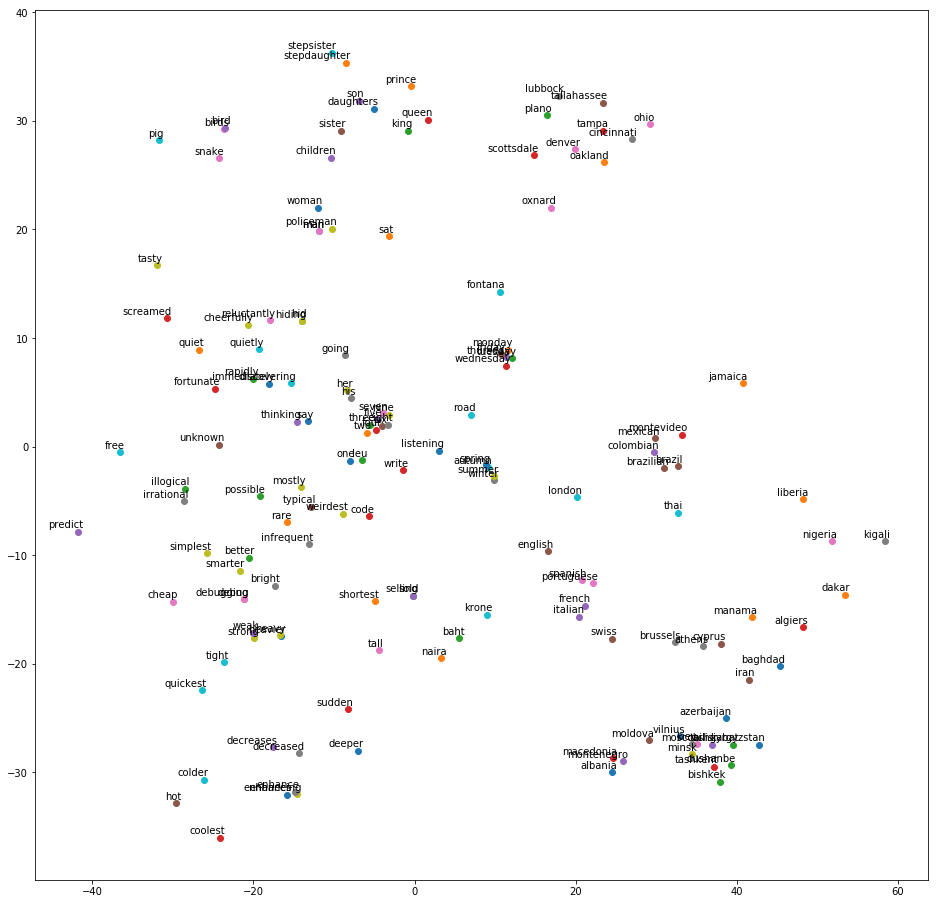

In [18]:
%%capture
num_words = 150
rich_words = get_semantically_rich_words()
tsne_points = tsne_plot(large_model, rich_words, plot_num=num_words)

## Poincare embeddings - tSNE plot

##### NOTE: I believe that tSNE is assuming a Euclidean structure for the space where the input points come from. So this plot, with tSNE applied on points from the Poincare ball should be taken with a grain of salt

In [22]:
large_hyp_model_fn = os.path.join(ROOT, "models/geometric_emb/w2v_levy_sg_5_600_A025_a0001_n5_w5_c100_poincare")
large_hyp_model = gensim.models.Word2Vec.load(large_hyp_model_fn)
wv = large_hyp_model.wv

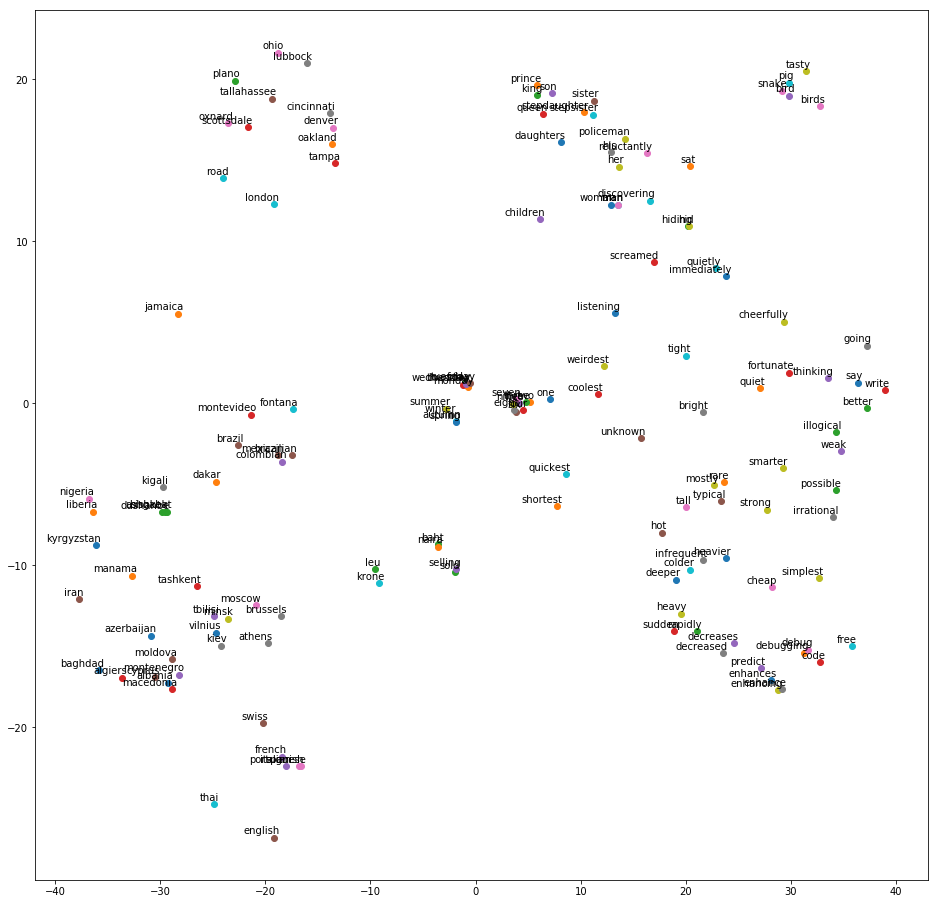

In [23]:
%%capture
rich_words = get_semantically_rich_words()
hyp_tsne_points = tsne_plot(large_hyp_model, rich_words, plot_num=150)

(150, 2)
(150, 2, 2, 2)


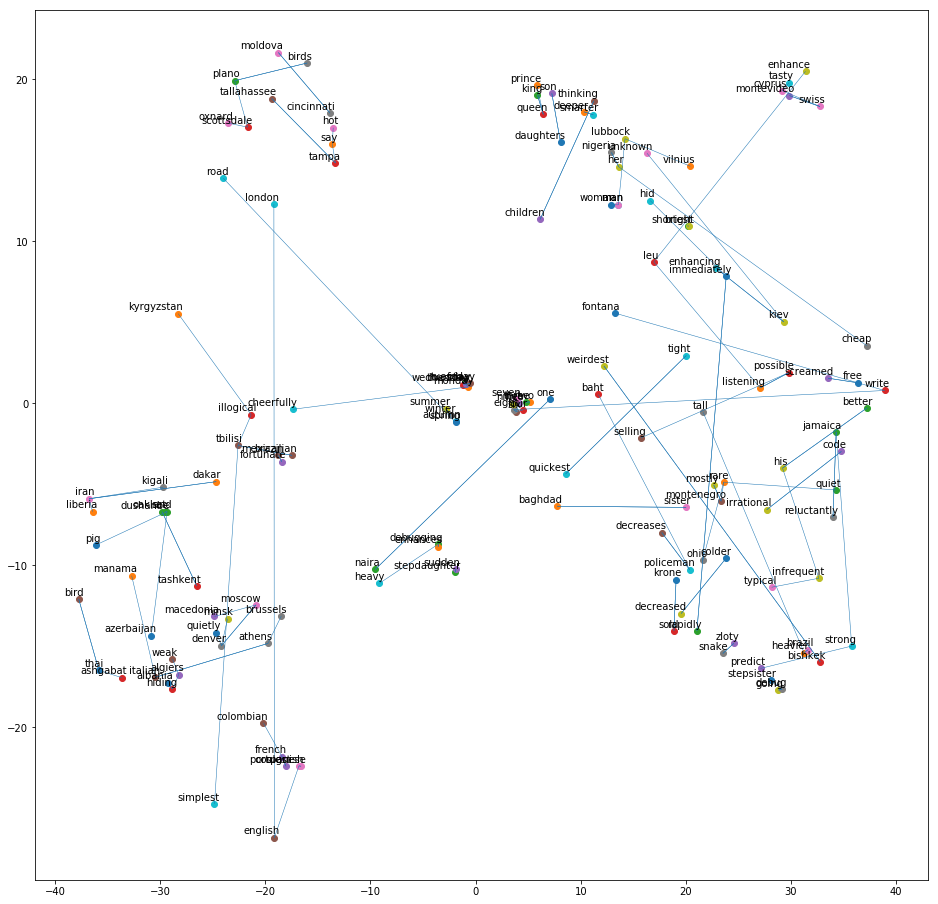

In [39]:
draw_neighbor_connections(points=hyp_tsne_points, num_words=num_words, neighbor_idxs=neighbors)

# Evolution of 2D embeddings during training

In [3]:
def plot_frame(ckpt, frame, restrict_vocab=100, labels=[]):
    restrict_vocab = min(restrict_vocab, len(ckpt.checkpoints))
    
    # Filter labels that we don't have checkpoints for.
    labels = list(filter(lambda l: l in ckpt.checkpoints, labels))

    labels = list(ckpt.checkpoints.keys())[:restrict_vocab][:15] if not labels else labels
    # Labels need to be at the beginning of the `embeddings` array.
    embeddings = np.array([ckpt.checkpoints[l] for l in labels] + list(ckpt.checkpoints.values()))[:restrict_vocab, frame, :]  # #words * vector_size
    
    colors = list(itertools.islice(iter(cm.rainbow(np.linspace(0, 1, restrict_vocab))), restrict_vocab))
        
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111)
    ax.scatter(embeddings[:, 0], embeddings[:, 1], color=colors)
    annotations = []
    for idx in range(len(labels)):
        word = labels[idx]
        ann = plt.annotate(word, embeddings[idx, :])
        ann.set_animated(True)
        annotations.append(ann)
            
    
def create_emb_ckpt_animation(ckpt, restrict_vocab=100, frames=None, labels=[], verbose=False):
    restrict_vocab = min(restrict_vocab, len(ckpt.checkpoints))
    
    # Filter labels that we don't have checkpoints for.
    labels = list(filter(lambda l: l in ckpt.checkpoints, labels))

    labels = list(ckpt.checkpoints.keys())[:restrict_vocab][:15] if not labels else labels
    # Labels need to be at the beginning of the `embeddings` array.
    embeddings = np.array([ckpt.checkpoints[l] for l in labels] + list(ckpt.checkpoints.values()))[:restrict_vocab, :frames, :]  # #words * #ckpts * vector_size
    
    frames = min(frames, embeddings.shape[1]) if frames else embeddings.shape[1]
    if verbose:
        print(len(ckpt.word_list), len(ckpt.checkpoints)) 
        print(embeddings.shape)
        print(restrict_vocab, len(labels))

    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111)
    if ckpt.emb_type == "cosine":
        ax.set_xlim([-0.5, 3.5])
        ax.set_ylim([-3.5, 1])
    elif ckpt.emb_type == "poincare":
        ax.set_xlim([-1, 1])
        ax.set_ylim([-1, 1])

    colors = list(itertools.islice(iter(cm.rainbow(np.linspace(0, 1, restrict_vocab))), restrict_vocab))
    l1 = ax.scatter(embeddings[:, 0, 0], embeddings[:, 0, 1], color=colors)

    annotations = []
    for idx in range(len(labels)):
        word = labels[idx]
        ann = plt.annotate(word, embeddings[idx, 0, :])
        ann.set_animated(True)
        annotations.append(ann)

    def init():
        l1.set_offsets([[np.nan]*restrict_vocab]*2)
        return [l1] + annotations

    def animate(i):
        l1.set_offsets(embeddings[:, i, :])

        for idx, ann in enumerate(annotations):
            annotations[idx].set_position(embeddings[idx, i, :])

        return [l1] + annotations

    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=frames, interval=400, 
                                   blit=True)
    plt.close()
    return HTML(anim.to_jshtml())

label_list = [
    "one", "two", "three", "four", "five", "six", "seven",
    "son", "daughter", "mother", "father", "grandson", "granddaughter", 
    "queen", "king", "prince",
    "winter", "summer", "autumn", "spring",
    "monday", "tuesday", "wednesday", "thursday", "friday",
    "french", "english", "spanish", "chinese", "indian",
    "man", "woman", "men", "women"]

### 2D dot product embeddings

In [63]:
emb_type = "cosine"
ckpt_file = os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_sg_3_2_A001_a0001_n5_w5_c50_cosine_OPTsgd")
ckpt = gensim.models.word2vec.WordEmbeddingCheckpoints.load(ckpt_file)
ckpt.emb_type = emb_type
dot_prod_ani = create_emb_ckpt_animation(ckpt, restrict_vocab=150, frames=20, labels=label_list)

In [64]:
dot_prod_ani

### 2D Poincare embeddings

In [6]:
# WARNING! Might take a few minutes to run. Don't run this cell unless necessary.
# Predefined animations.
emb_type = "poincare"
ckpt_files = {
    "sg_5ep": os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_sg_5_2_A025_a0001_n5_w5_c50_poincare"),
    "sg_5ep_bias": os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_sg_5_2_A025_a0001_n5_w5_c50_poincare_bias"),
    "sg_1ep_bias_l2reg-1.0": os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_sg_1_2_A025_a0001_n5_w5_c50_poincare_l-1.0_bias"),
    "nll_5ep_lr0.025": os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_nll_5_2_A025_a0001_n5_w5_c50_poincare"),
    "nll_5ep_lr0.001": os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_nll_5_2_A001_a0001_n5_w5_c50_poincare"),
    "nll_5ep_lr0.001_bias": os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_nll_5_2_A001_a0001_n5_w5_c50_poincare_bias"),
    "nll_5ep_lr0.001_bias_burnin3": os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_nll_5_2_A001_a0001_n5_w5_c50_poincare_bias_burnin3"),
    "nll_3ep_wfullrsgd_burnin1": os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_nll_3_2_A005_a001_n5_w5_c50_poincare_OPTwfullrsgd_bias_burnin1"),
    "nll_3ep_wrsgd_burnin1": os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_nll_3_2_A005_a001_n5_w5_c50_poincare_OPTwrsgd_bias_burnin1"),
    "nll_3ep_wfullrsgd_INITid0.01": os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_nll_3_2_A005_a001_n5_w5_c50_poincare_OPTwfullrsgd_INITid0.01_bias"),
    "nll_3ep_wfullrsgd_INITid0.9": os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_nll_3_2_A005_a001_n5_w5_c50_poincare_OPTwfullrsgd_INITid0.9_bias"),
    "nll_3ep_wfullrsgd_INITexp0.9": os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_nll_3_2_A005_a001_n5_w5_c50_poincare_OPTwfullrsgd_INITexp0.9_bias"),
}

hyp_anim = {}
for label, file in ckpt_files.items():
    print("Generating animation for {}..".format(label))
    ckpt = gensim.models.word2vec.WordEmbeddingCheckpoints.load(file)
    ckpt.emb_type = emb_type
    hyp_anim[label] = create_emb_ckpt_animation(ckpt, restrict_vocab=100, frames=None, labels=label_list)

SyntaxError: invalid syntax (<ipython-input-6-44b4595d8c94>, line 13)

In [56]:
# Custom animation.
emb_type = "poincare"
# ckpt_file = os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_nll_2_2_A005_a001_n5_w5_c50_poincare_bias")
# ckpt_file = os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_nll_3_2_A005_a001_n5_w5_c50_poincare_OPTwfullrsgd_INITid0.1")
# ckpt_file = os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_nll_3_2_A005_a0001_n5_w5_c50_poincare_OPTwfullrsgd_SIMcosh-dist-sq")
# ckpt_file = os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_sg_10_2_A001_a001_n5_w5_c50_poincare_OPTwfullrsgd_SIMcosh-dist-sq_border-init") # init target vectors between [0.8, 0.85]; init all context vectors at 0
ckpt_file = os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_nll_4_2_A005_a005_n5_w5_c50_poincare_OPTwfullrsgd_SIMcosh-dist-sq_border-init") # init target vectors between [0.8, 0.85]; init all context vectors at 0
ckpt_file = os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_nll_15_2_A001_a001_n5_w5_c50_poincare_OPTwfullrsgd_SIMcosh-dist-sq_border-init") # init target vectors between [0.8, 0.85]; init context vectors between [0.5, 0.6]

ckpt = gensim.models.word2vec.WordEmbeddingCheckpoints.load(ckpt_file)
ckpt.emb_type = emb_type
custom_poincare_ani = create_emb_ckpt_animation(ckpt, restrict_vocab=100, frames=None, labels=label_list, verbose=True)

726 720
(100, 928, 2)
100 34


/usr/local/lib/python3.6/site-packages/matplotlib/animation.py:973: UserWarning:

Animation size has reached 20993696 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.



In [57]:
# hyp_anim["nll_3ep_wfullrsgd_INITid0"]
custom_poincare_ani

In [99]:
wfullrsgd_ckpt_file = os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_nll_3_2_A005_a001_n5_w5_c50_poincare_OPTwfullrsgd_bias_burnin1")
wfullrsgd_ckpt = gensim.models.word2vec.WordEmbeddingCheckpoints.load(wfullrsgd_ckpt_file)
wfullrsgd_ckpt.emb_type = emb_type

wrsgd_ckpt_file = os.path.join(ROOT, "word_emb_checkpoints/emb_ckpt_text8_nll_3_2_A005_a001_n5_w5_c50_poincare_OPTwrsgd_bias_burnin1")
wrsgd_ckpt = gensim.models.word2vec.WordEmbeddingCheckpoints.load(wrsgd_ckpt_file)
wrsgd_ckpt.emb_type = emb_type

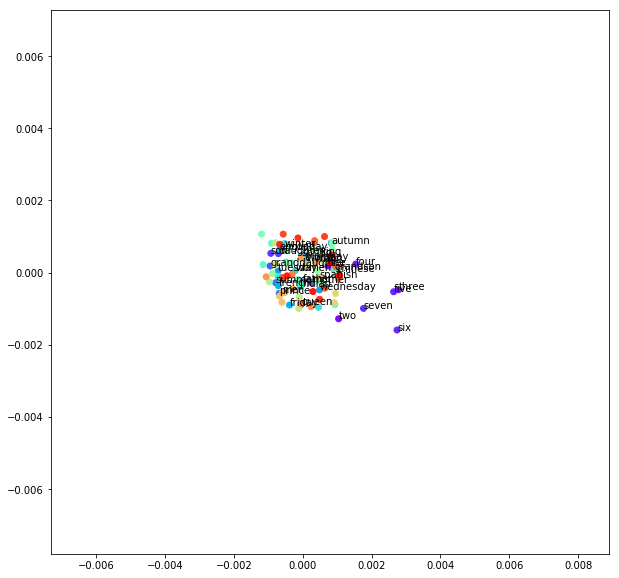

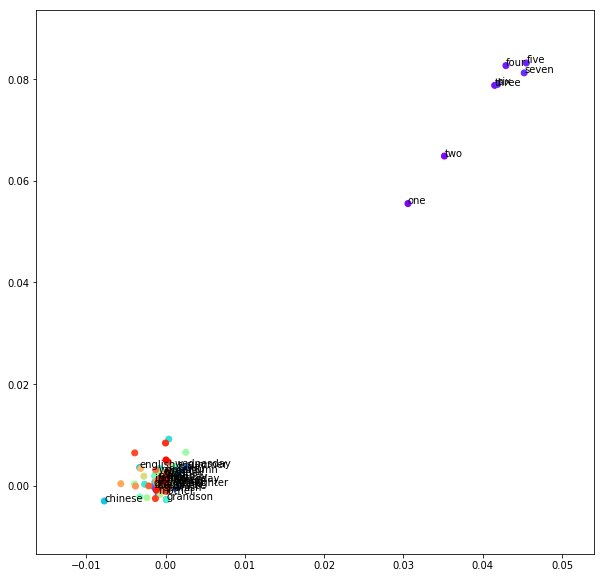

In [111]:
frame = 60
plot_frame(wfullrsgd_ckpt, frame=frame, restrict_vocab=100, labels=label_list)
plot_frame(wrsgd_ckpt, frame=frame, restrict_vocab=100, labels=label_list)